In [1]:
# Основные фреймворки
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Отключение ворнингов
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Настройка визуализации
import matplotlib
TEXT_COLOR = 'black'

matplotlib.rcParams['figure.figsize'] = (15, 10)
matplotlib.rcParams['text.color'] = TEXT_COLOR
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['lines.markersize'] = 15
matplotlib.rcParams['axes.labelcolor'] = TEXT_COLOR
matplotlib.rcParams['xtick.color'] = TEXT_COLOR
matplotlib.rcParams['ytick.color'] = TEXT_COLOR

sns.set_style('darkgrid')

In [3]:
# Импорт используемых фреймворков
from statsmodels.tsa.stattools import adfuller
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

------------------

### Задача:
Имеется система распределения воды, оснащенная несколькими насосами. Один из насосов несколько раз выходил из строя, что влекло к остановке водоснабжения. Для предотвращения сбоев в системе необходимо заранее обнаруживать ненормальное поведение системы.

Насос оснащен 52 датчиками, которые номируются от 00 до 51.


In [4]:
# Загрузка данных
df = pd.read_csv('sensor.csv', index_col=['timestamp'], parse_dates=['timestamp'], dayfirst=True).drop('Unnamed: 0', axis=1)
df.head()

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,2.465394,47.09201,53.2118,46.310760,634.3750,76.45975,13.41146,16.13136,15.56713,15.05353,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2018-04-01 00:01:00,2.465394,47.09201,53.2118,46.310760,634.3750,76.45975,13.41146,16.13136,15.56713,15.05353,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2018-04-01 00:02:00,2.444734,47.35243,53.2118,46.397570,638.8889,73.54598,13.32465,16.03733,15.61777,15.01013,...,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037,NORMAL
2018-04-01 00:03:00,2.460474,47.09201,53.1684,46.397568,628.1250,76.98898,13.31742,16.24711,15.69734,15.08247,...,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,240.4514,203.1250,NORMAL
2018-04-01 00:04:00,2.445718,47.13541,53.2118,46.397568,636.4583,76.58897,13.35359,16.21094,15.69734,15.08247,...,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,242.1875,201.3889,NORMAL


In [5]:
# Размер данных
df.shape

(220320, 53)

In [6]:
# Временной диапазон 
start = df.index[0]
stop = df.index[-1]
print(f'Начало измерений: {start}')
print(f'Конец измерений: {stop}')
print(f'Временной диапазон: {stop - start}')
print(f'Шаг измерений: {df.index[1] - df.index[0]}')

Начало измерений: 2018-04-01 00:00:00
Конец измерений: 2018-08-31 23:59:00
Временной диапазон: 152 days 23:59:00
Шаг измерений: 0 days 00:01:00


Данные представляют 220320 измерений 51 датчика в период с 2018-04-01 00:00:00 по 2018-08-31 23:59:00.

### Первоначальный анализ данных:

Пропуски в данных:

In [7]:
# Пропуски  в данных, пропуски данных в %, тип данных
df_nans = pd.DataFrame([df.isna().sum(), 100*(df.isna().sum()/len(df)), df.dtypes, ], index=['NAN', 'NAN_%', 'TYPE']).T.sort_values(by='NAN', ascending=False)
df_nans

,NAN,NAN_%,TYPE
sensor_15,220320,100.0,float64
sensor_50,77017,34.956881,float64
sensor_51,15383,6.982117,float64
sensor_00,10208,4.633261,float64
sensor_07,5451,2.474129,float64
sensor_08,5107,2.317992,float64
sensor_06,4798,2.177741,float64
sensor_09,4595,2.085603,float64
sensor_01,369,0.167484,float64
sensor_30,261,0.118464,float64


- 15 датчик имеет 100% пропусков, поэтому эту колонку можно удалить.
- Некоторые группы датчиков имеют одинаковое количество пропусков: 27, 19, 16.
- 5 датчик имеет 1/3 пропусков. Восстановление пропусков в данных может быть затруднительным или исказить исходную информацию.

Все признаки кроме "machine_status" имеют тип данных "float". Также признак "machine_status" единственный признак без пропусков значений. Рассмотрим какие значения принимает данный признак.

In [8]:
# Уникальные значения столбца состояния системы
df.machine_status.value_counts()

NORMAL        205836
RECOVERING     14477
BROKEN             7
Name: machine_status, dtype: int64

"machine_status" описывает статус системы и принимает 3 значения:
1. НОРМАЛЬНЫЙ
2. ВОССТАНОВЛЕНИЕ
3. ПОЛОМКА

Если рассмотреть данный признак как целевой, то наблюдается явный дисбаланс.

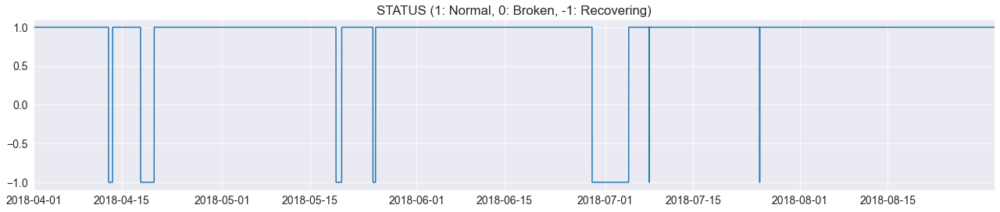

In [9]:
status = pd.DataFrame(df.machine_status)
status['target'] = 1
status.loc[status.machine_status=='BROKEN'] = 0
status.loc[status.machine_status=='RECOVERING'] = -1

_ = plt.figure(figsize=(18,4))
_ = plt.plot(status.target)
plt.title('STATUS (1: Normal, 0: Broken, -1: Recovering)')
plt.xlim(start, stop)
plt.tight_layout()
plt.show()

Выполним визуализацию показаний датчиков с учетом статуса насоса.

In [10]:
df_broken = df[df.machine_status=='BROKEN']
df_recovering = df[df.machine_status=='RECOVERING']

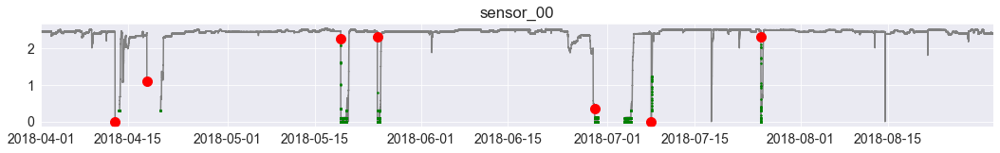

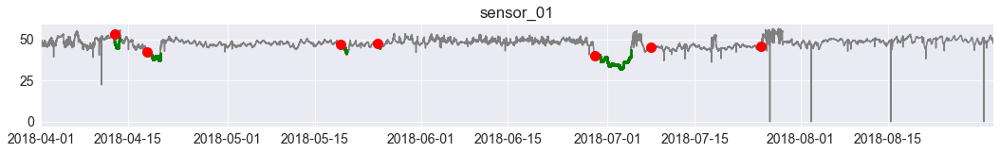

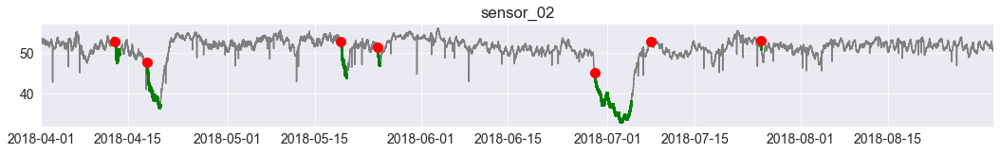

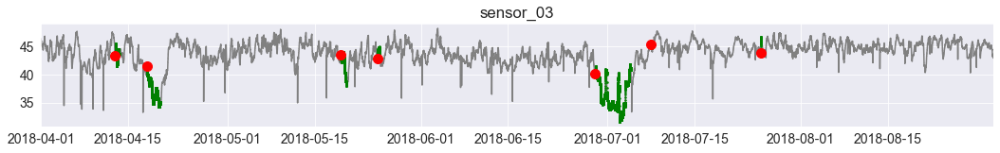

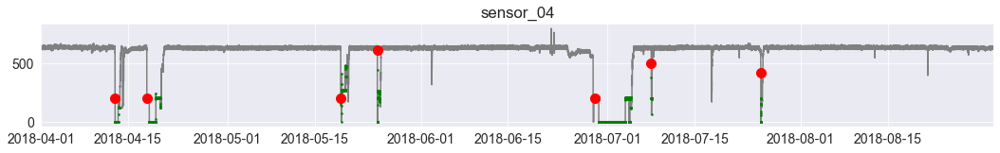

...

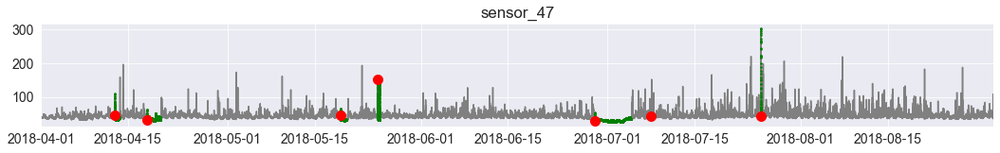

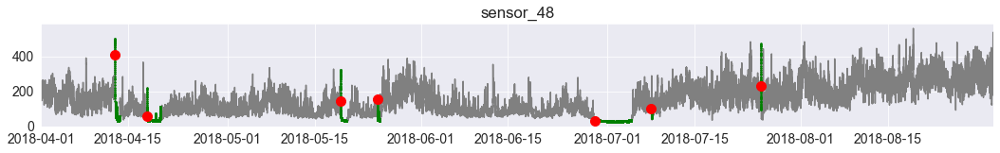

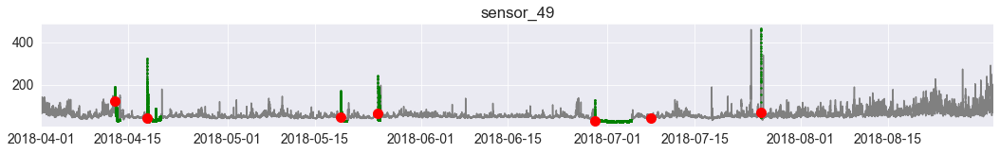

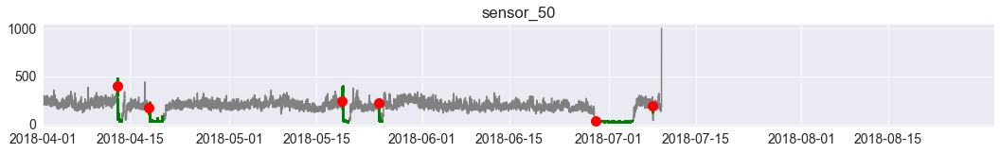

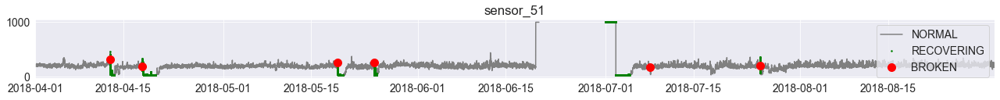

In [11]:
# Визуализация показаний всех датчиков сиситемы
for sensor in df.columns[:-1]:
    _ = plt.figure(figsize=(18,2))
    _ = plt.plot(df[sensor], color='grey', label='NORMAL')
    _ = plt.plot(df_recovering[sensor], linestyle='none', marker='.', color='g', markersize=3, label='RECOVERING', )
    _ = plt.plot(df_broken[sensor], linestyle='none', marker='o', color='r', markersize=10, label='BROKEN')
    _ = plt.title(sensor)
    plt.xlim(start, stop)
plt.legend(loc='upper right')   
plt.tight_layout()
plt.show()

По такому виду графика видно, что определённые показания датчиков можно выделить в группы по "схожести" сигнала. 

- 01-03
- 04-09
- 10-12
- 14-18
- 19-24
- 25-33 (кроме 31)
- 31, 34-36
- 38-39, 41-44
- 45-47, 40

Рассмотрим данные, в которых больше 2% пропусков, с учетом статуса "BROKEN".

In [12]:
df = df.drop('sensor_15', axis=1)
df_nans = df_nans.drop('sensor_15', axis=0)

In [13]:
sensor_nan = df_nans.loc[df_nans['NAN_%']>2].index
sensor_nan

Index(['sensor_50', 'sensor_51', 'sensor_00', 'sensor_07', 'sensor_08',
       'sensor_06', 'sensor_09'],
      dtype='object')

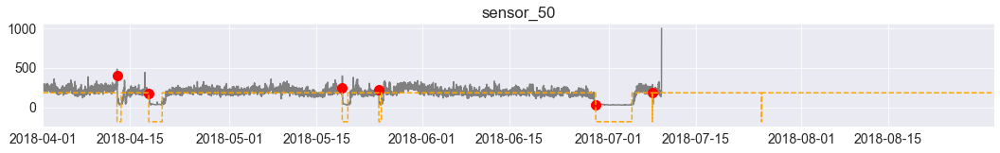

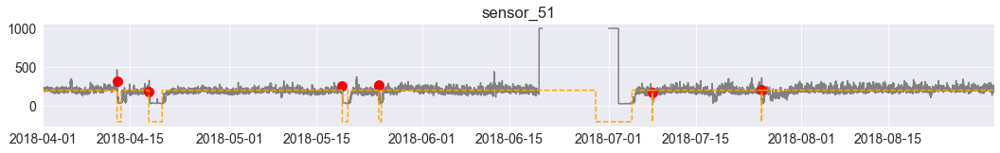

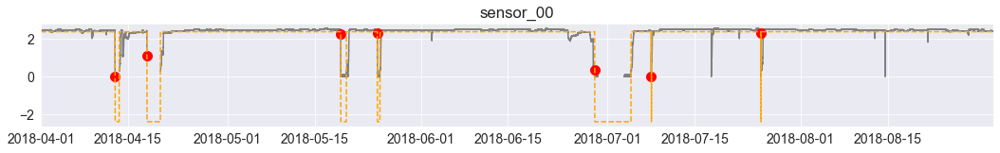

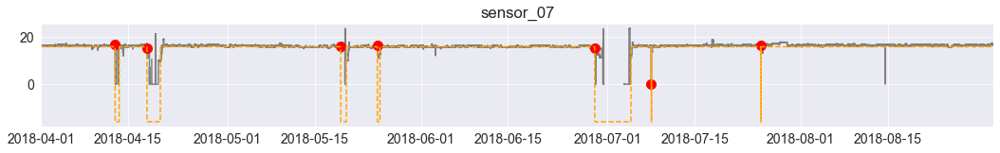

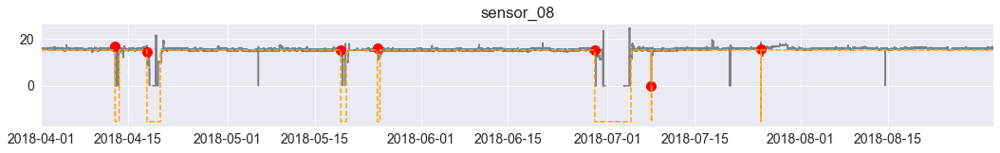

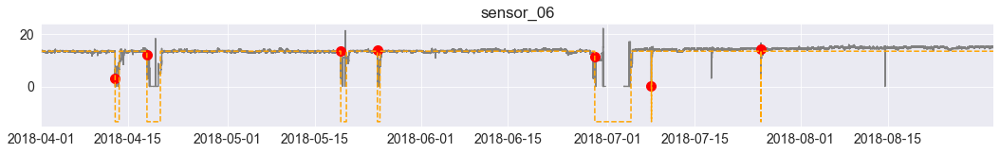

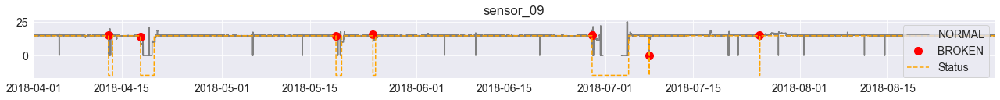

In [51]:
for sensor in sensor_nan:
    _ = plt.figure(figsize=(18,2))
    _ = plt.plot(df[sensor], color='grey', label='NORMAL')
    _ = plt.plot(df_broken[sensor], linestyle='none', marker='o', color='r', markersize=10, label='BROKEN')
    _ = plt.title(sensor)
    _ = plt.plot(df[sensor].mean()*status.target, linestyle='--', color='orange', label='Status')
    plt.xlim(start, stop)
plt.legend(loc='upper right')   
plt.tight_layout()
plt.show()

- Сигнал на графиках датчиков 06-09 выглядят похоже. 
- По маркерам поломок видно, что не все "пики" соответствуют отказу насоса.
- 50 датчик перестаёт функционировать после 6-го отказа.
- После 5-го отказа в датчиках 06-09 наибольшее количество пропусков значений.

Большинство пропущенных значений в данных наблюдаются после 5-го отказа, показания датчиков при этом падают в значение 0. Поэтому значения NaN в датчиках: 00, 06, 07, 08, 09 возможно заменить на 0. В датчике 51 значения пропадают после резкого скачка показаний к максимальному значению.

Рассмотрим границы измерений (min, max) и среднее значение.

In [15]:
# Минимальное, максимальное и среднее значение
df.describe().T[['min', '50%', 'max']].sort_values(by='50%')

,min,50%,max
sensor_00,0.000000,2.456539,2.549016
sensor_18,0.000000,2.533704,4.873250
sensor_13,0.000000,2.929809,31.187550
sensor_06,0.014468,13.642940,22.251160
sensor_09,0.000000,15.082470,25.000000
sensor_08,0.028935,15.494790,24.348960
sensor_07,0.000000,16.167530,23.596640
sensor_12,0.000000,32.515830,45.000000
sensor_41,20.833330,34.895832,420.312500
sensor_42,22.135416,35.156250,374.218800


- Датчики аналоговые (значения непрерывные)
- Нет отрицательных значений
- Максимальное значение в виде целых чисел может говорить о достижении заданных ограничений (что видно по графикам)

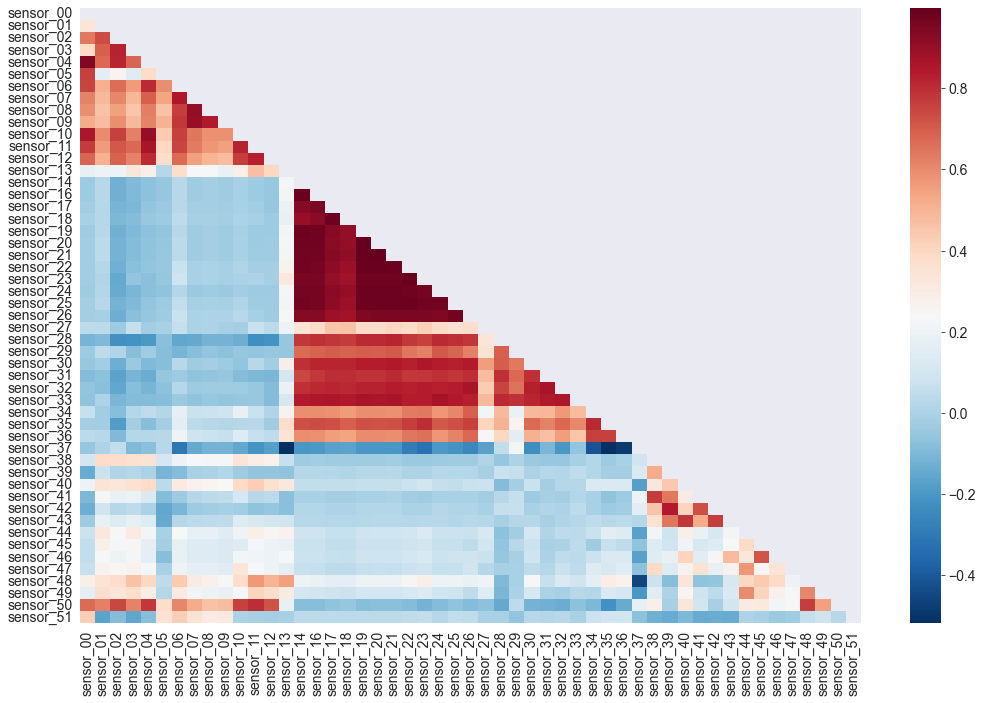

In [16]:
# Матрица корреляций
corr_mtrx = df.corr()

mask = np.zeros_like(corr_mtrx)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corr_mtrx, xticklabels=corr_mtrx.columns, yticklabels=corr_mtrx.columns, cmap='RdBu_r', annot=False, mask = mask)
plt.tight_layout()
plt.show()

In [17]:
sns.pairplot(df[df.columns[14:26]], corner=True, height=10)

Наибольшие корреляции между датчиками от 14 до 26. 

Так как основная задача проекта - обнаружение аномалий, то перед реализацией модели необходимо задаться вопросом о "природе" выбросов (т.е. чем они могут быть вызваны).

### Предобработка данных:

**Заполнение пропусков**

- В датчиках: 00, 06, 07, 08, 09 замени NaN  на 0.
- Остальные датчиках заменим пропуски медианным значением.

In [18]:
nan_to_zero = ['sensor_00', 'sensor_07', 'sensor_08', 'sensor_06', 'sensor_09']
nan_to_median = df.drop(nan_to_zero, axis=1).columns[:-1]

df_fill = df.copy()
for sensor in nan_to_median:
    df_fill[sensor].fillna(value=df_fill[sensor].median(), inplace=True)
    
for sensor in nan_to_zero:
    df_fill[sensor].fillna(value=0, inplace=True)
    
df_fill.isna().sum()

sensor_00         0
sensor_01         0
sensor_02         0
sensor_03         0
sensor_04         0
sensor_05         0
sensor_06         0
sensor_07         0
sensor_08         0
sensor_09         0
sensor_10         0
sensor_11         0
sensor_12         0
sensor_13         0
sensor_14         0
sensor_16         0
sensor_17         0
sensor_18         0
sensor_19         0
sensor_20         0
sensor_21         0
sensor_22         0
sensor_23         0
sensor_24         0
sensor_25         0
sensor_26         0
sensor_27         0
sensor_28         0
sensor_29         0
sensor_30         0
sensor_31         0
sensor_32         0
sensor_33         0
sensor_34         0
sensor_35         0
sensor_36         0
sensor_37         0
sensor_38         0
sensor_39         0
sensor_40         0
sensor_41         0
sensor_42         0
sensor_43         0
sensor_44         0
sensor_45         0
sensor_46         0
sensor_47         0
sensor_48         0
sensor_49         0
sensor_50         0


**Отбор признаков**

Так как в таблице данных достаточно много признаков, которые образуют группы по схожести и некоторые из признаков имеют достаточно высокий коэффицент корреляции, то необходимо выбрать несколько "основных" признаков.

Воспользуемся алгоритмом PCA для отбора признаков и уменьшения размерности данных. Так как признаки имеют разный масштаб измерний применим StandartScaler, чтобы привести данные к одной размерности.

In [19]:
x_col = df_fill.columns[:-1]    # Переменная, хранящая только названия колонок с датчиками
X = df_fill[x_col]

In [20]:
scaler = StandardScaler()
pca = PCA()
pipeline = make_pipeline(scaler, pca)
pipeline.fit(X)

Pipeline(steps=[('standardscaler', StandardScaler()), ('pca', PCA())])

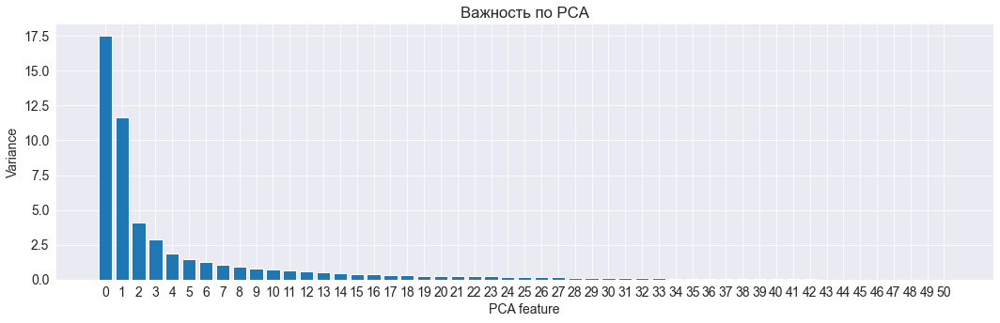

In [21]:
# Визцализация полученных результатов
features = range(pca.n_components_)
_ = plt.figure(figsize=(15, 5))
_ = plt.bar(features, pca.explained_variance_)
_ = plt.xlabel('PCA feature')
_ = plt.ylabel('Variance')
_ = plt.xticks(features)
_ = plt.title("Важность по PCA")
plt.tight_layout()
plt.show()

По графику видно, что наиболее важными компонентами являются компоненты 0 и 1. Также возьмем еще компонент под номером 2. Сведем выбранные данные в отдельную таблицу.

In [22]:
pca = PCA(n_components=3)
Components = pca.fit_transform(X)
pca_results = pd.DataFrame(data=Components, columns=['PC0', 'PC1', 'PC2'])
pca_results

,PC0,PC1,PC2
0,69.863661,264.824188,-429.680701
1,69.863661,264.824188,-429.680701
2,28.183115,282.594634,-401.691185
3,24.889024,289.380014,-371.408401
4,29.968634,293.754098,-391.413590
...,...,...,...
220315,-308.451320,-274.699179,78.909374
220316,-294.526112,-256.447392,46.401216
220317,-300.127817,-257.039271,56.884031
220318,-285.061597,-263.212722,61.274097


Проверим полученные компоненты на стационраность при помощи критерия Дикки-Фуллера.

In [23]:
%%time
print(f'p-value Д-Ф для PC0: {adfuller(pca_results.PC0)[1]}')
print(f'p-value Д-Ф для PC1: {adfuller(pca_results.PC1)[1]}')
print(f'p-value Д-Ф для PC2: {adfuller(pca_results.PC2)[1]}')

p-value Д-Ф для PC0: 2.4713534774893417e-05
p-value Д-Ф для PC1: 1.7706188647430667e-06
p-value Д-Ф для PC2: 9.591593300090913e-16
Wall time: 8min 5s


Значения p многим меньше 0.05, что дает возможно отклонить нулевую гепотизу о нестационарности ряда. То есть оба ряда являются стационарными.

Также воспользуемся встроенной функцией SelectKBest для отбора призаков.

In [24]:
# SelectKBest
scaler = MinMaxScaler((0,1))
X_scaled = scaler.fit_transform(X)
y = df.machine_status

select_features = SelectKBest(score_func=chi2, k=3)
features = select_features.fit(X_scaled, y)
df_score = pd.DataFrame(features.scores_)
df_columns = pd.DataFrame(X.columns)
feature_scores = pd.concat([df_columns, df_score], axis=1)
feature_scores.columns = ['Feature', 'Score']
feature_scores.nlargest(3, 'Score')

,Feature,Score
0,sensor_00,13556.259202
11,sensor_11,10122.905617
12,sensor_12,9892.421019


----------------------------------------------------------------------------

**IQR**

Выполним поиск аномалий при помощи межквартильных расстояний полученных компонент.

In [25]:
def IQR_func(PC):
    # Функция рассчета межквартильного расстояния, верхней и нижней границы наблюдаемых значений
    
    q1, q3 = PC.quantile([0.25, 0.75])
    IQR = q3 - q1
    lower = q1 - (1.5 * IQR)    # Нижняя граница
    upper = q3 + (1.5 * IQR)    # Верхняя граница
    return IQR, lower, upper

In [26]:
IQR_PC0, lower_PC0, upper_PC0 = IQR_func(pca_results.PC0)
print(f'lower PC0: {lower_PC0}, upper PC0: {upper_PC0}')

IQR_PC1, lower_PC1, upper_PC1 = IQR_func(pca_results.PC1)
print(f'lower PC1: {lower_PC1}, upper PC1: {upper_PC1}')

IQR_PC2, lower_PC2, upper_PC2 = IQR_func(pca_results.PC2)
print(f'lower P20: {lower_PC2}, upper PC2: {upper_PC2}')

lower PC0: -740.7940484619986, upper PC0: 222.6619780235383
lower PC1: -734.4578467860233, upper PC1: 678.4067512156897
lower P20: -316.12180096557006, upper PC2: 297.4827482761155


Все показания, которые находятся за пределами нижней или верхней границы будем считать аномалиями.

In [27]:
# Количество аномалий (0 - не аномалия, 1 - аномалия)
pca_results['anomaly_PC0'] = ((pca_results.PC0>upper_PC0) | (pca_results.PC0<lower_PC0)).astype(int)
pca_results['anomaly_PC1'] = ((pca_results.PC1>upper_PC1) | (pca_results.PC1<lower_PC1)).astype(int)
pca_results['anomaly_PC2'] = ((pca_results.PC2>upper_PC2) | (pca_results.PC2<lower_PC2)).astype(int)
print(f'Anomaly in PC0: \n{pca_results.anomaly_PC0.value_counts()}')
print('---------------------------------')
print(f'Anomaly in PC1: \n{pca_results.anomaly_PC1.value_counts()}')
print('---------------------------------')
print(f'Anomaly in PC2: \n{pca_results.anomaly_PC2.value_counts()}')

Anomaly in PC0: 
0    190150
1     30170
Name: anomaly_PC0, dtype: int64
---------------------------------
Anomaly in PC1: 
0    218702
1      1618
Name: anomaly_PC1, dtype: int64
---------------------------------
Anomaly in PC2: 
0    203209
1     17111
Name: anomaly_PC2, dtype: int64


In [28]:
# В процентном соотношении
print(f'Выбросы в PC0: {round(100 * len(pca_results.loc[pca_results.anomaly_PC0==1])/len(df), 3)}')
print(f'Выбросы в PC1: {round(100* len(pca_results.loc[pca_results.anomaly_PC1==1])/len(df), 3)}')
print(f'Выбросы в PC2: {round(100* len(pca_results.loc[pca_results.anomaly_PC2==1])/len(df), 3)}')

Выбросы в PC0: 13.694
Выбросы в PC1: 0.734
Выбросы в PC2: 7.766


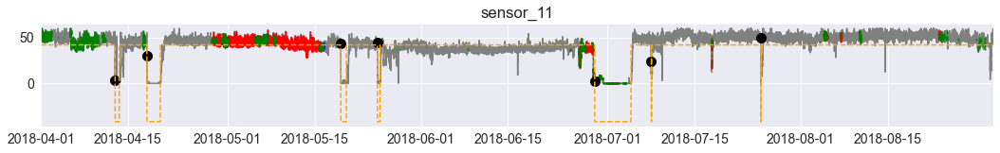

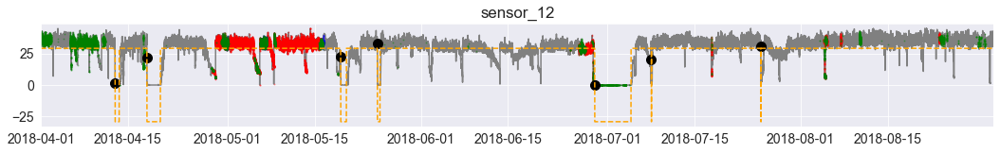

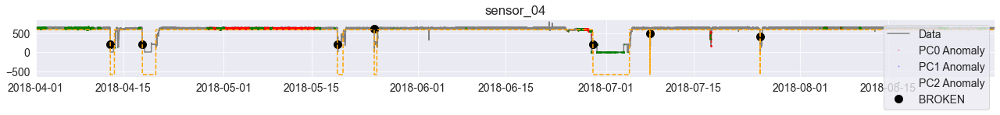

In [41]:
# Визуализация
best_features = df[['sensor_11', 'sensor_12', 'sensor_04']]
pca_results.index = df.index
best_features[['anomaly_PC0', 'anomaly_PC1', 'anomaly_PC2']] = pca_results[['anomaly_PC0', 'anomaly_PC1', 'anomaly_PC2']]

for sensor in ['sensor_11', 'sensor_12', 'sensor_04']:
    _ = plt.figure(figsize=(18,2))
    _ = plt.plot(best_features[sensor], color='grey', label='Data')
    _ = plt.plot(best_features.loc[best_features.anomaly_PC0==1][sensor], linestyle='none', color='r', marker ='.', markersize=2, alpha=.3, label = 'PC0 Anomaly')
    _ = plt.plot(best_features.loc[best_features.anomaly_PC1==1][sensor], linestyle='none', color='b', marker ='.', markersize=2, alpha=.3, label = 'PC1 Anomaly')
    _ = plt.plot(best_features.loc[best_features.anomaly_PC2==1][sensor], linestyle='none', color='g', marker ='.', markersize=2, alpha=.3, label = 'PC2 Anomaly')
    _ = plt.plot(df_broken[sensor], linestyle='none', marker='o', color='black', markersize=10, label='BROKEN')
    _ = plt.title(sensor)
    _ = plt.plot(df[sensor].mean()*status.target, linestyle='--', color='orange', label='Status')
    plt.xlim(start, stop) 
plt.legend(loc='upper right')   
plt.tight_layout()
plt.show()

По графикам сигналов видно, что обнаруженные аномалии при помощи метода межквартильных расстояний находятся перед точками "BROKEN". Наибольшая концентрация аномальных значений перед 3-им отказом насоса. 

Данная информация может рассматриваться как сигнал о возможной скорой поломке насоса, что является полезным оповещением для оператора и выполнения действий, предотвращающих остановку системы.  

----------------------------------------------------------------------------

**Isolation Forest**

Создаем модель Isolation Forest, в параметрах указываем только долю выбросов. Обучаем на результатах, полученный после PCA,  на этих же данных делаем предсказания. 

In [43]:
# Пусть 13 процентов данных - это аномалии
outliers_fraction = 0.13    # доля выбросов

forest_model = IsolationForest(contamination=outliers_fraction)
forest_model.fit(pca_results[['PC0', 'PC1', 'PC2']].values)
best_features['forest_anomaly'] = pd.Series(data = forest_model.predict(pca_results[['PC0', 'PC1', 'PC2']].values), index = pca_results.index)

In [44]:
print(f'Anomaly in Isolation Forest: \n{best_features.forest_anomaly.value_counts()}')

Anomaly in Isolation Forest: 
 1    191678
-1     28642
Name: forest_anomaly, dtype: int64


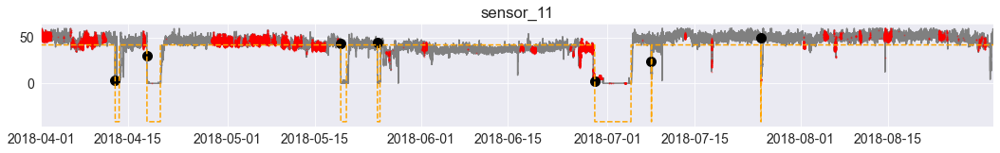

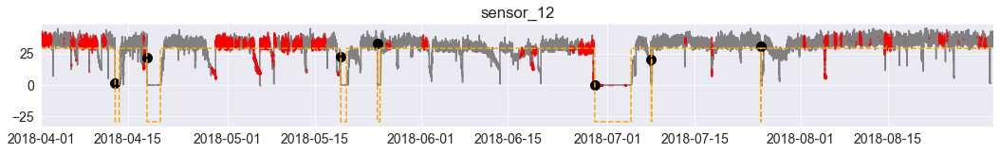

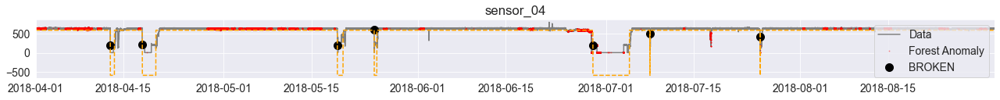

In [45]:
# Визуализация аномалий, обнаруженных при помощи Isolation Forest
for sensor in ['sensor_11', 'sensor_12', 'sensor_04']:
    _ = plt.figure(figsize=(18,2))
    _ = plt.plot(best_features[sensor], color='grey', label='Data')
    _ = plt.plot(best_features.loc[best_features.forest_anomaly==-1][sensor], linestyle='none', color='r', marker ='.', markersize=2, alpha=.3, label = 'Forest Anomaly')
    _ = plt.plot(df_broken[sensor], linestyle='none', marker='o', color='black', markersize=10, label='BROKEN')
    _ = plt.title(sensor)
    _ = plt.plot(df[sensor].mean()*status.target, linestyle='--', color='orange')
    plt.xlim(start, stop) 
plt.legend(loc='upper right')   
plt.tight_layout()
plt.show()

Как и в методе с использованием IQR найденные аномальные значения располагаются перед точками "BROKEN". Наибольшее скопление аномальных точек также перед 3-ей поломкой насоса. При использовании Изолирующего Леса после 7-ой поломки найдено больше аномалий в отличии от метода IQR.

----------------------------------------------------------------------------

**Kmeans**

Создаем модель Kmeans. Обучаем на результатах, полученный после PCA, и на этих же данных делаем предсказания и получаем количество элементов в соответствии определенным кластерам. 

In [46]:
kmeans_model = KMeans(n_clusters=3, random_state=42)
kmeans_model.fit(pca_results[['PC0', 'PC1', 'PC2']].values)
labels = kmeans_model.predict(pca_results[['PC0', 'PC1', 'PC2']].values)
unique_elements, counts_elements = np.unique(labels, return_counts=True)
clusters = np.asanyarray((unique_elements, counts_elements))

In [47]:
def calculate_distance(df, model):
    # Функция считает расстояния между точками и центром ближайшего кластера
    # Большие расстояния будут считаться аномалиями
    
    index = df.index
    df.index = np.arange(len(df))
    distance = []
    for i in range(len(df)):
        a = np.array(df.loc[i])
        b = model.cluster_centers_[model.labels_[i]-1]
        # .labels_ - метка каждой точки
        # .cluster_centers_ - координаты центров кластеров
        distance.append(np.linalg.norm(a-b))
        # np.linalg.norm() - линейная алгебра, рассчет нормы
        
    return pd.Series(distance, index)

In [48]:
# Пусть 13 процентов данных - это аномалии
outliers_fraction = 0.13    # доля выбросов

distance = calculate_distance(pca_results[['PC0', 'PC1', 'PC2']], kmeans_model)
number_of_outliers = int(outliers_fraction*len(distance))    # число данных с аномалиями
threshold = distance.nlargest(number_of_outliers).min()      # порог из 13% выбранных данных
best_features['kmeans_anomaly'] = (distance >= threshold).astype(int)

In [49]:
print(f'Anomaly in Kmeans: \n{best_features.kmeans_anomaly.value_counts()}')

Anomaly in Kmeans: 
0    191679
1     28641
Name: kmeans_anomaly, dtype: int64


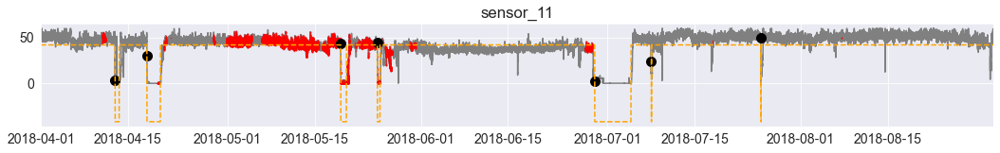

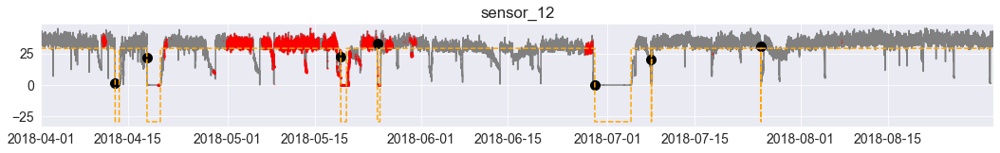

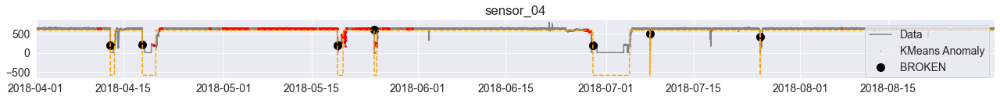

In [50]:
# Визуализация аномалий, обнаруженных при помощи KMeans
for sensor in ['sensor_11', 'sensor_12', 'sensor_04']:
    _ = plt.figure(figsize=(18,2))
    _ = plt.plot(best_features[sensor], color='grey', label='Data')
    _ = plt.plot(best_features.loc[best_features.kmeans_anomaly==1][sensor], linestyle='none', color='r', marker ='.', markersize=2, alpha=.3, label = 'KMeans Anomaly')
    _ = plt.plot(df_broken[sensor], linestyle='none', marker='o', color='black', markersize=10, label='BROKEN')
    _ = plt.title(sensor)
    _ = plt.plot(df[sensor].mean()*status.target, linestyle='--', color='orange')
    plt.xlim(start, stop) 
plt.legend(loc='upper right')   
plt.tight_layout()
plt.show()

В отличии от двух первых методов при использовании алгоритма KMeans после 5-ой поломки насоса колличество аномалий резко уменьшается.

In [38]:
----------------------

SyntaxError: invalid syntax (<ipython-input-38-d20d9fbb9e3d>, line 1)

Рассмотрим графики автокорреляции и частичной автокорреляции.